# Clustering Geolocation Data Intelligently in Python
We have taxi rank locations, and want to define key clusters of these taxis where we can build service stations for all taxis operating in that region.


## Project Outline

[**Task 1**](#task1): Exploratory Data Analysis

[**Task 2**](#task2): Visualizing Geographical Data

[**Task 3**](#task3): Clustering Strength / Performance Metric

[**Task 4**](#task4): K-Means Clustering

[**Task 5**](#task5): DBSCAN

[**Task 6**](#task6): HDBSCAN

[**Task 7**](#task7): Addressing Outliers

[**Further Reading**](#further)

In [ ]:
 # https://medium.com/analytics-vidhya/clustering-geo-location-dbscan-cadb33b0442e <IGNORE THE ABOVE, just using the below as a reference 

In [135]:
import matplotlib
%matplotlib inline
%config InlineBackend.figure_format = 'svg'
import matplotlib.pyplot as plt
plt.style.use('ggplot')

import pandas as pd  
import numpy as np
import seaborn as sns
from tqdm import tqdm

from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.datasets import make_blobs
from sklearn.neighbors import KNeighborsClassifier

from ipywidgets import interactive

from collections import defaultdict

import hdbscan
import folium
import re


cols = ['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4',
        '#46f0f0', '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff', 
        '#9a6324', '#fffac8', '#800000', '#aaffc3', '#808000', '#ffd8b1', 
        '#000075', '#808080']*10

sns.set(style="white")

<a id='task1'></a>
# Task 1: Exploratory Data Analysis

In [136]:
df = pd.read_csv('TrafficIn2018-2020forREF.csv')


In [137]:
df.head()

,Unnamed: 0,NAME,DESCRIPTION,START_DT,MODIFIED_DT,QUADRANT,LON,LAT,location,Count,...,Temperature,DewPoint,RelativeHumidity,PrecipitationAmount,WindDirection,WindSpeed,Visibility,Pressure,Humidex,Weather
0,0,Southbound Centre Street and 7 Avenue NW,Multi-vehicle incident. Blocking the right lane,2020-01-01 0:48,NaN,NaN,-114.062534,51.058878,"(51.058877650372736, -114.06253421508985)",1,...,1.4,-4.4,65,,33,7,16.1,86.63,,NaN
1,1,3619 61 Avenue SE,There is an incident involving a pedestrian.,2020-01-01 4:33,NaN,NaN,-113.981403,50.998056,"(50.99805614728498, -113.98140314534284)",1,...,-1.5,-4.9,78,,1,6,16.1,86.59,,Mostly Cloudy
2,2,Northbound Deerfoot Trail at 16 Avenue NE,Single vehicle incident. Blocking the right lane,2020-01-01 4:48,NaN,NaN,-114.026760,51.067193,"(51.067192947356034, -114.02675988940585)",1,...,-1.5,-4.9,78,,1,6,16.1,86.59,,Mostly Cloudy
3,3,Mcknight Boulevard and Centre Street NW,There is an incident involving a pedestrian.,2020-01-01 5:57,NaN,NaN,-114.062464,51.096035,"(51.09603510653257, -114.06246397138388)",1,...,-2,-5.5,77,,18,4,16.1,86.57,,NaN
4,4,Glenmore Trail at 69 Street SW,Two vehicle incident.,2020-01-01 17:41,NaN,NaN,-114.198465,51.014694,"(51.014693706800706, -114.19846524569348)",1,...,-1,-3.2,85,,17,3,24.1,87.14,,NaN


In [138]:
df.duplicated(subset=['LON', 'LAT']).values.any()

True

In [139]:
df.isna().values.any()

True

In [140]:
print(f'Before dropping NaNs and dupes\t:\tdf.shape = {df.shape}')


df.drop_duplicates(subset=['LON', 'LAT'], keep='first', inplace=True)
print(f'After dropping NaNs and dupes\t:\tdf.shape = {df.shape}')

Before dropping NaNs and dupes	:	df.shape = (5781, 22)
After dropping NaNs and dupes	:	df.shape = (4158, 22)


In [141]:
df.head()

,Unnamed: 0,NAME,DESCRIPTION,START_DT,MODIFIED_DT,QUADRANT,LON,LAT,location,Count,...,Temperature,DewPoint,RelativeHumidity,PrecipitationAmount,WindDirection,WindSpeed,Visibility,Pressure,Humidex,Weather
0,0,Southbound Centre Street and 7 Avenue NW,Multi-vehicle incident. Blocking the right lane,2020-01-01 0:48,NaN,NaN,-114.062534,51.058878,"(51.058877650372736, -114.06253421508985)",1,...,1.4,-4.4,65,,33,7,16.1,86.63,,NaN
1,1,3619 61 Avenue SE,There is an incident involving a pedestrian.,2020-01-01 4:33,NaN,NaN,-113.981403,50.998056,"(50.99805614728498, -113.98140314534284)",1,...,-1.5,-4.9,78,,1,6,16.1,86.59,,Mostly Cloudy
2,2,Northbound Deerfoot Trail at 16 Avenue NE,Single vehicle incident. Blocking the right lane,2020-01-01 4:48,NaN,NaN,-114.026760,51.067193,"(51.067192947356034, -114.02675988940585)",1,...,-1.5,-4.9,78,,1,6,16.1,86.59,,Mostly Cloudy
3,3,Mcknight Boulevard and Centre Street NW,There is an incident involving a pedestrian.,2020-01-01 5:57,NaN,NaN,-114.062464,51.096035,"(51.09603510653257, -114.06246397138388)",1,...,-2,-5.5,77,,18,4,16.1,86.57,,NaN
4,4,Glenmore Trail at 69 Street SW,Two vehicle incident.,2020-01-01 17:41,NaN,NaN,-114.198465,51.014694,"(51.014693706800706, -114.19846524569348)",1,...,-1,-3.2,85,,17,3,24.1,87.14,,NaN


In [142]:
X = np.array(df[['LON', 'LAT']], dtype='float64')

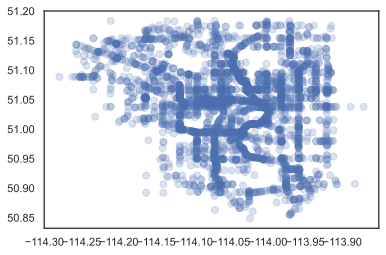

In [143]:
plt.scatter(X[:,0], X[:,1], alpha=0.2, s=50)

<a id='task2'></a>
# Task 2: Visualizing Geographical Data


In [144]:
m = folium.Map(location=[df.LAT.mean(), df.LON.mean()], zoom_start=9, 
               tiles='OpenStreet Map')

for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row.LAT, row.LON],
        radius=5,
        popup=re.sub(r'[^a-zA-Z ]+', '', row.NAME),
        color='#1787FE',
        fill=True,
        fill_colour='#1787FE'
    ).add_to(m)

In [145]:
m

<a id='task3'></a>
# Task 3: Clustering Strength / Performance Metric

In [146]:
X_blobs, _ = make_blobs(n_samples=1000, centers=10, n_features=2, 
                        cluster_std=0.5, random_state=4)

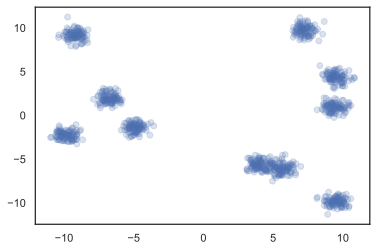

In [147]:
plt.scatter(X_blobs[:,0], X_blobs[:,1], alpha=0.2)

In [148]:
class_predictions = np.load('sample_clusters.npy')

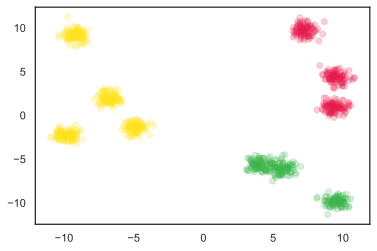

In [149]:
unique_clusters = np.unique(class_predictions)
for unique_cluster in unique_clusters:
    X = X_blobs[class_predictions==unique_cluster]
    plt.scatter(X[:,0], X[:,1], alpha=0.2, c=cols[unique_cluster])

In [150]:
silhouette_score(X_blobs, class_predictions)

0.6657220862867241

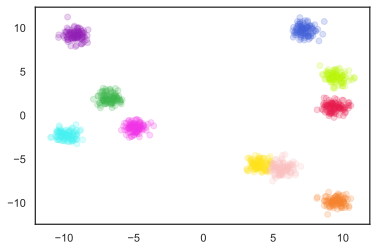

In [151]:
class_predictions = np.load('sample_clusters_improved.npy')
unique_clusters = np.unique(class_predictions)
for unique_cluster in unique_clusters:
    X = X_blobs[class_predictions==unique_cluster]
    plt.scatter(X[:,0], X[:,1], alpha=0.2, c=cols[unique_cluster])

In [152]:
silhouette_score(X_blobs, class_predictions)

0.7473587799908298

<a id='task4'></a>
# Task 4: K-Means Clustering

In [153]:
X_blobs, _ = make_blobs(n_samples=1000, centers=50, 
                        n_features=2, cluster_std=1, random_state=4)

In [154]:
data = defaultdict(dict)
for x in range(1,21):
    model = KMeans(n_clusters=3, random_state=17, 
                   max_iter=x, n_init=1).fit(X_blobs)
    
    data[x]['class_predictions'] = model.predict(X_blobs)
    data[x]['centroids'] = model.cluster_centers_
    data[x]['unique_classes'] = np.unique(class_predictions)

In [155]:
def f(x):
    class_predictions = data[x]['class_predictions']
    centroids = data[x]['centroids']
    unique_classes = data[x]['unique_classes']

    for unique_class in unique_classes:
            plt.scatter(X_blobs[class_predictions==unique_class][:,0], 
                        X_blobs[class_predictions==unique_class][:,1], 
                        alpha=0.3, c=cols[unique_class])
    plt.scatter(centroids[:,0], centroids[:,1], s=200, c='#000000', marker='v')
    plt.ylim([-15,15]); plt.xlim([-15,15])
    plt.title('How K-Means Clusters')

interactive_plot = interactive(f, x=(1, 20))
output = interactive_plot.children[-1]
output.layout.height = '350px'
interactive_plot

interactive(children=(IntSlider(value=10, description='x', max=20, min=1), Output(layout=Layout(height='350px'…

In [156]:
X = np.array(df[['LON', 'LAT']], dtype='float64')
k = 70
model = KMeans(n_clusters=k, random_state=17).fit(X)
class_predictions = model.predict(X)
df[f'CLUSTER_kmeans{k}'] = class_predictions

In [157]:
df.head()

,Unnamed: 0,NAME,DESCRIPTION,START_DT,MODIFIED_DT,QUADRANT,LON,LAT,location,Count,...,DewPoint,RelativeHumidity,PrecipitationAmount,WindDirection,WindSpeed,Visibility,Pressure,Humidex,Weather,CLUSTER_kmeans70
0,0,Southbound Centre Street and 7 Avenue NW,Multi-vehicle incident. Blocking the right lane,2020-01-01 0:48,NaN,NaN,-114.062534,51.058878,"(51.058877650372736, -114.06253421508985)",1,...,-4.4,65,,33,7,16.1,86.63,,NaN,38
1,1,3619 61 Avenue SE,There is an incident involving a pedestrian.,2020-01-01 4:33,NaN,NaN,-113.981403,50.998056,"(50.99805614728498, -113.98140314534284)",1,...,-4.9,78,,1,6,16.1,86.59,,Mostly Cloudy,45
2,2,Northbound Deerfoot Trail at 16 Avenue NE,Single vehicle incident. Blocking the right lane,2020-01-01 4:48,NaN,NaN,-114.026760,51.067193,"(51.067192947356034, -114.02675988940585)",1,...,-4.9,78,,1,6,16.1,86.59,,Mostly Cloudy,17
3,3,Mcknight Boulevard and Centre Street NW,There is an incident involving a pedestrian.,2020-01-01 5:57,NaN,NaN,-114.062464,51.096035,"(51.09603510653257, -114.06246397138388)",1,...,-5.5,77,,18,4,16.1,86.57,,NaN,61
4,4,Glenmore Trail at 69 Street SW,Two vehicle incident.,2020-01-01 17:41,NaN,NaN,-114.198465,51.014694,"(51.014693706800706, -114.19846524569348)",1,...,-3.2,85,,17,3,24.1,87.14,,NaN,44


In [158]:
def create_map(df, cluster_column):
    m = folium.Map(location=[df.LAT.mean(), df.LON.mean()], zoom_start=9, tiles='OpenStreet Map')

    for _, row in df.iterrows():

        if row[cluster_column] == -1:
            cluster_colour = '#000000'
        else:
            cluster_colour = cols[row[cluster_column]]

        folium.CircleMarker(
            location= [row['LAT'], row['LON']],
            radius=5,
            popup= row[cluster_column],
            color=cluster_colour,
            fill=True,
            fill_color=cluster_colour
        ).add_to(m)
        
    return m

m = create_map(df, 'CLUSTER_kmeans70')
print(f'K={k}')
print(f'Silhouette Score: {silhouette_score(X, class_predictions)}')

m.save('kmeans_70.html')

K=70
Silhouette Score: 0.4342454391667435


In [159]:
m

In [160]:
best_silhouette, best_k = -1, 0

for k in tqdm(range(2, 100)):
    model = KMeans(n_clusters=k, random_state=1).fit(X)
    class_predictions = model.predict(X)
    
    curr_silhouette = silhouette_score(X, class_predictions)
    if curr_silhouette > best_silhouette:
        best_k = k
        best_silhouette = curr_silhouette
        
print(f'K={best_k}')
print(f'Silhouette Score: {best_silhouette}') 

100%|██████████████████████████████████████████████████████████████████████████████████| 98/98 [01:09<00:00,  1.42it/s]

K=92
Silhouette Score: 0.4563691846663101


<a id='task5'></a>
# Task 5: DBSCAN 
Density-Based Spatial Clustering of Applications with Noise

In [161]:
# code for indexing out certain values
dummy = np.array([-1, -1, -1, 2, 3, 4, 5, -1])

new = np.array([(counter+2)*x if x==-1 else x for counter, x in enumerate(dummy)])

In [162]:
model = DBSCAN(eps=0.01, min_samples=5).fit(X)
class_predictions = model.labels_

df['CLUSTERS_DBSCAN'] = class_predictions

In [163]:
m = create_map(df, 'CLUSTERS_DBSCAN')

    
print(f'Number of clusters found: {len(np.unique(class_predictions))}')
print(f'Number of outliers found: {len(class_predictions[class_predictions==-1])}')

print(f'Silhouette ignoring outliers: {silhouette_score(X[class_predictions!=-1], class_predictions[class_predictions!=-1])}')

no_outliers = 0
no_outliers = np.array([(counter+2)*x if x==-1 else x for counter, x in enumerate(class_predictions)])
print(f'Silhouette outliers as singletons: {silhouette_score(X, no_outliers)}')

Number of clusters found: 11
Number of outliers found: 62
Silhouette ignoring outliers: -0.29421416419128454
Silhouette outliers as singletons: -0.5248703029785025


In [164]:
m

<a id='task6'></a>
# Task 6: HDBSCAN
Hierarchical DBSCAN

In [165]:
model = hdbscan.HDBSCAN(min_cluster_size=5, min_samples=2, 
                        cluster_selection_epsilon=0.01)
#min_cluster_size
#min_samples
#cluster_slection_epsilon

class_predictions = model.fit_predict(X)
df['CLUSTER_HDBSCAN'] = class_predictions

In [166]:
m = create_map(df, 'CLUSTER_HDBSCAN')

print(f'Number of clusters found: {len(np.unique(class_predictions))-1}')
print(f'Number of outliers found: {len(class_predictions[class_predictions==-1])}')

print(f'Silhouette ignoring outliers: {silhouette_score(X[class_predictions!=-1], class_predictions[class_predictions!=-1])}')

no_outliers = np.array([(counter+2)*x if x==-1 else x for counter, x in enumerate(class_predictions)])
print(f'Silhouette outliers as singletons: {silhouette_score(X, no_outliers)}')

m

Number of clusters found: 10
Number of outliers found: 58
Silhouette ignoring outliers: -0.2850971659969781
Silhouette outliers as singletons: -0.564637194876943


In [167]:
hdbscan.HDBSCAN?

<a id='task7'></a>
# Task 7: Addressing Outliers


In [168]:
classifier = KNeighborsClassifier(n_neighbors=1)

In [169]:
df_train = df[df.CLUSTER_HDBSCAN!=-1]
df_predict = df[df.CLUSTER_HDBSCAN==-1]

In [170]:
X_train = np.array(df_train[['LON', 'LAT']], dtype='float64')
y_train = np.array(df_train['CLUSTER_HDBSCAN'])

X_predict = np.array(df_predict[['LON', 'LAT']], dtype='float64')

In [171]:
classifier.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=1)

In [172]:
predictions = classifier.predict(X_predict)

In [173]:
df['CLUSTER_hybrid'] = df['CLUSTER_HDBSCAN']

In [174]:
df.loc[df.CLUSTER_HDBSCAN==-1, 'CLUSTER_hybrid'] = predictions

In [175]:
m = create_map(df, 'CLUSTER_hybrid')

In [176]:
m

In [177]:
class_predictions = df.CLUSTER_hybrid
print(f'Number of clusters found: {len(np.unique(class_predictions))}')
print(f'Silhouette: {silhouette_score(X, class_predictions)}')

m.save('hybrid.html')

Number of clusters found: 10
Silhouette: -0.2866104720926924


Text(0.5, 0, 'Cluster Sizes')

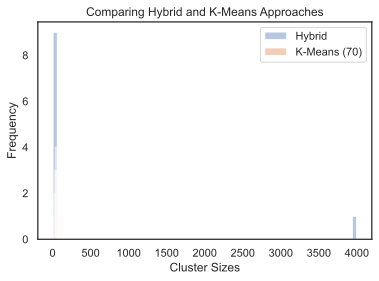

In [178]:
df['CLUSTER_hybrid'].value_counts().plot.hist(bins=70, alpha=0.4, 
                                              label='Hybrid')
df['CLUSTER_kmeans70'].value_counts().plot.hist(bins=70, alpha=0.4,
                                               label='K-Means (70)')
plt.legend()
plt.title('Comparing Hybrid and K-Means Approaches')
plt.xlabel('Cluster Sizes')